In [2]:
import pandas as pd
import numpy as np
import os, json, cv2, numpy as np, matplotlib.pyplot as plt

import torch
from torch.utils.data import Dataset, DataLoader

import torchvision
from torchvision.models.detection.rpn import AnchorGenerator
from torchvision.transforms import functional as F

import albumentations as A # Library for augmentations

from pathlib import Path

import transforms, utils, engine, train
from utils import collate_fn
from engine import train_one_epoch, evaluate

In [3]:
keypoints_classes_ids2names = np.arange(25)

def visualize(image, bboxes, keypoints, image_original=None, bboxes_original=None, keypoints_original=None):
    fontsize = 18

    for bbox in bboxes:
        start_point = (bbox[0], bbox[1])
        end_point = (bbox[2], bbox[3])
        image = cv2.rectangle(image.copy(), start_point, end_point, (0,255,0), 2)
    
    for kps in keypoints:
        for idx, kp in enumerate(kps):
            image = cv2.circle(image.copy(), tuple(kp), 1, (255,0,0), 5)
            image = cv2.putText(image.copy(), " " + str(keypoints_classes_ids2names[idx]), tuple(kp), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255,0,0), 3, cv2.LINE_AA)
        # print(kps)
        cv2.polylines(image, [np.array(kps)[:6]], isClosed = True, color = (0,0,255), thickness = 2, lineType = cv2.LINE_AA)
        cv2.polylines(image, [np.array(kps)[6:12]], isClosed = True, color = (0,0,255), thickness = 2, lineType = cv2.LINE_AA)
        cv2.polylines(image, [np.array(kps)[12:]], isClosed = True, color = (0,0,255), thickness = 2, lineType = cv2.LINE_AA)

    if image_original is None and keypoints_original is None:
        plt.figure(figsize=(40,40))
        plt.imshow(image)

    else:
        for bbox in bboxes_original:
            start_point = (bbox[0], bbox[1])
            end_point = (bbox[2], bbox[3])
            image_original = cv2.rectangle(image_original.copy(), start_point, end_point, (0,255,0), 2)
        
        for kps in keypoints_original:
            for idx, kp in enumerate(kps):
                image_original = cv2.circle(image_original, tuple(kp), 5, (255,0,0), 10)
                image_original = cv2.putText(image_original, " " + str(keypoints_classes_ids2names[idx]), tuple(kp), cv2.FONT_HERSHEY_SIMPLEX, 1, (255,0,0), 3, cv2.LINE_AA)

        f, ax = plt.subplots(1, 2, figsize=(40, 20))

        ax[0].imshow(image_original)
        ax[0].set_title('Original image', fontsize=fontsize)

        ax[1].imshow(image)
        ax[1].set_title('Transformed image', fontsize=fontsize)
        
# image = (batch[0][0].permute(1,2,0).numpy() * 255).astype(np.uint8)
# bboxes = batch[1][0]['boxes'].detach().cpu().numpy().astype(np.int32).tolist()

# keypoints = []
# for kps in batch[1][0]['keypoints'].detach().cpu().numpy().astype(np.int32).tolist():
#     keypoints.append([kp[:2] for kp in kps])

# image_original = (batch[2][0].permute(1,2,0).numpy() * 255).astype(np.uint8)
# bboxes_original = batch[3][0]['boxes'].detach().cpu().numpy().astype(np.int32).tolist()

# keypoints_original = []
# for kps in batch[3][0]['keypoints'].detach().cpu().numpy().astype(np.int32).tolist():
#     keypoints_original.append([kp[:2] for kp in kps])

# visualize(image, bboxes, keypoints)

In [4]:
def get_model(num_keypoints, weights_path=None):
    
    anchor_generator = AnchorGenerator(sizes=(32, 64, 128, 256, 512), aspect_ratios=(0.25, 0.5, 0.75, 1.0, 2.0, 3.0, 4.0))
    model = torchvision.models.detection.keypointrcnn_resnet50_fpn(pretrained=False,
                                                                   pretrained_backbone=True,
                                                                   num_keypoints=num_keypoints,
                                                                   num_classes = 2, # Background is the first class, object is the second class
                                                                   rpn_anchor_generator=anchor_generator)

    if weights_path:
        state_dict = torch.load(weights_path)["model"]
        model.load_state_dict(state_dict)        
        
    return model

In [5]:
last_weights = str(sorted(list(Path("/content/drive/MyDrive/glue/").glob("keypointsrcnn_sixclothes_checkpoint_epoch_*.pth")))[-1])
model = get_model(num_keypoints = 2, weights_path = last_weights)

Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth


  0%|          | 0.00/97.8M [00:00<?, ?B/s]

RuntimeError: ignored

In [ ]:
test = pd.read_csv('random_test_data.csv')
from ast import literal_eval
for elt in ['landmarks_right_sleeve', 'landmarks_left_sleeve']:
    test.loc[:, elt] = test.loc[:, elt].apply(lambda x: literal_eval(x))
def transform_tuple_to_list(x):
    return [list(e) for e in x] #[list(x) for x in test.landmarks_right_sleeve.iloc[0]]
    # print(x[-1])
test.landmarks_right_sleeve = test.landmarks_right_sleeve.apply(transform_tuple_to_list)
test.landmarks_left_sleeve = test.landmarks_left_sleeve.apply(transform_tuple_to_list)
def keep_two_el(x):
    return x[:2]
def keep_first_and_last_kp(x):
    for i in range(len(x)):
        return list(map(keep_two_el, x))[::5]
        # print(x[i])

test.landmarks_right_sleeve = test.landmarks_right_sleeve.apply(keep_first_and_last_kp)
test.landmarks_left_sleeve = test.landmarks_left_sleeve.apply(keep_first_and_last_kp)
def flatten_list_of_lists(x):
    flat_list = []
    for sublist in x:
        for item in sublist:
            flat_list.append(item)
    return flat_list

test.landmarks_right_sleeve = test.landmarks_right_sleeve.apply(flatten_list_of_lists)
test.landmarks_left_sleeve = test.landmarks_left_sleeve.apply(flatten_list_of_lists)

In [ ]:
def compute_distance(x1, y1, x2, y2):
    return (((x2-x1)**2) + ((y2-y1)**2))**0.5

In [ ]:
# l = flatten_list_of_lists(keypoints)
# l = flatten_list_of_lists(l)

In [8]:
from PIL import Image
from torchvision import transforms

device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
model = get_model(num_keypoints = 18)
model.load_state_dict(torch.load('/content/drive/MyDrive/glue/keypointsrcnn_sixclothes_checkpoint_epoch_13.pth')['model'])
model.to(device)
model.eval()

torch.save(model, '/content/keypoints_rcnn.pth')


# 1ère image

In [ ]:
from PIL import Image
from torchvision import transforms

device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
model = get_model(num_keypoints = 18)
model.load_state_dict(torch.load('/content/drive/MyDrive/glue/keypointsrcnn_sixclothes_checkpoint_epoch_13.pth')['model'])
model.to(device)
model.eval()

transform = transforms.ToTensor()

img = Image.open("/content/images/011965d4dd01ebf9f38e4737f08522d51ec481fe_original.jpeg")

tensor_img = transform(img)

output = model([tensor_img.to(device)])

/usr/local/lib/python3.7/dist-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


In [ ]:
# for pred, gt in zip(img_pred_test, img_gt_test):
#     print(pred[0] - gt[0], "--------", pred[1] - gt[1])
# img_pred_test = output[0]["keypoints"][0].squeeze(0).detach().cpu().numpy()
# right_sleeves = test.landmarks_right_sleeve

In [ ]:
# cat /usr/local/lib/python3.7/dist-packages/pycocotools/cocoeval.py

In [ ]:
image = (tensor_img.permute(1,2,0).numpy() * 255).astype(np.uint8)
bboxes = [output[0]['boxes'][0].detach().cpu().numpy().astype(np.int32).tolist()]

keypoints = []
for kps in output[0]['keypoints'][0].detach().cpu().numpy().astype(np.int32).tolist():
    keypoints.append(kps[:-1])
keypoints = [keypoints]

visualize(image, bboxes, keypoints)

In [ ]:
def computeX1(x, x2):
  return x[0]-x2

def computeX2(x, y2):
  return x[2]-y2

def computeY1(x, x2):
  return x[1]-x2

def computeY2(x, y2):
  return x[3]-y2

In [ ]:
l = flatten_list_of_lists(keypoints)
l = flatten_list_of_lists(l)

In [ ]:
test['left_agg_x1'] = test.landmarks_left_sleeve.apply(computeX1, args=(l[12])) + test.landmarks_left_sleeve.apply(computeX1, args=(l[24]))
test['left_agg_x2'] = test.landmarks_left_sleeve.apply(computeX2, args=(l[12])) + test.landmarks_left_sleeve.apply(computeX, args=(l[24]))
test['right_agg'] = test.landmarks_right_sleeve.apply(computeY1, args=(l[24])) + test.landmarks_right_sleeve.apply(computeY1, args=(l[24]))

In [ ]:
test.right_agg.mean(), test.left_agg.mean()

(134.03544494720964, 62.290723981900456)

In [ ]:
import json

test_dict = json.load('test_dict_imgs.json')

distance manche gauche, distance manche droite

In [ ]:
test.landmarks_right_sleeve

0         [283, 81, 308, 45]
1         [293, 89, 320, 59]
2       [292, 249, 315, 167]
3       [520, 580, 524, 515]
4       [340, 178, 362, 112]
                ...         
2647    [380, 401, 362, 331]
2648    [433, 191, 443, 106]
2649    [575, 197, 585, 159]
2650    [507, 433, 524, 395]
2651     [362, 119, 348, 49]
Name: landmarks_right_sleeve, Length: 2652, dtype: object

In [ ]:
len(l)

36

In [ ]:
# d__gauche = test.landmarks_left_sleeve.apply(compute, args=(l[12], l[13]))
# d__droite = test.landmarks_left_sleeve.apply(compute, args=(l[23], l[24]))

In [ ]:
# d_gauche.max(), d_droite.max()

(661.6358515074587, 630.4323912998126)

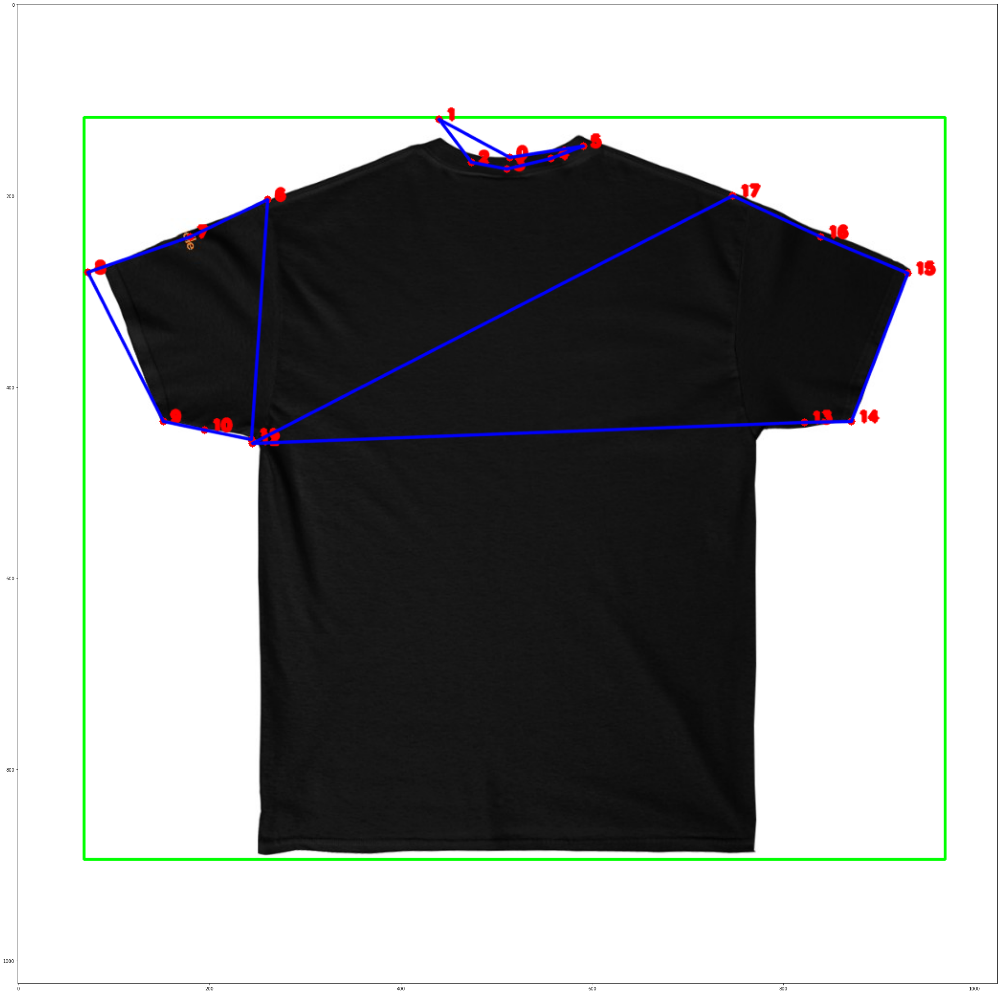

In [ ]:
img1 = Image.open("/content/images/22089-7.jpg")

tensor_img1 = transform(img1)

output1 = model([tensor_img1.to(device)])
image1 = (tensor_img1.permute(1,2,0).numpy() * 255).astype(np.uint8)
bboxes = [output1[0]['boxes'][0].detach().cpu().numpy().astype(np.int32).tolist()]

keypoints = []
for kps in output1[0]['keypoints'][0].detach().cpu().numpy().astype(np.int32).tolist():
    keypoints.append(kps[:-1])
keypoints = [keypoints]

visualize(image1, bboxes, keypoints)

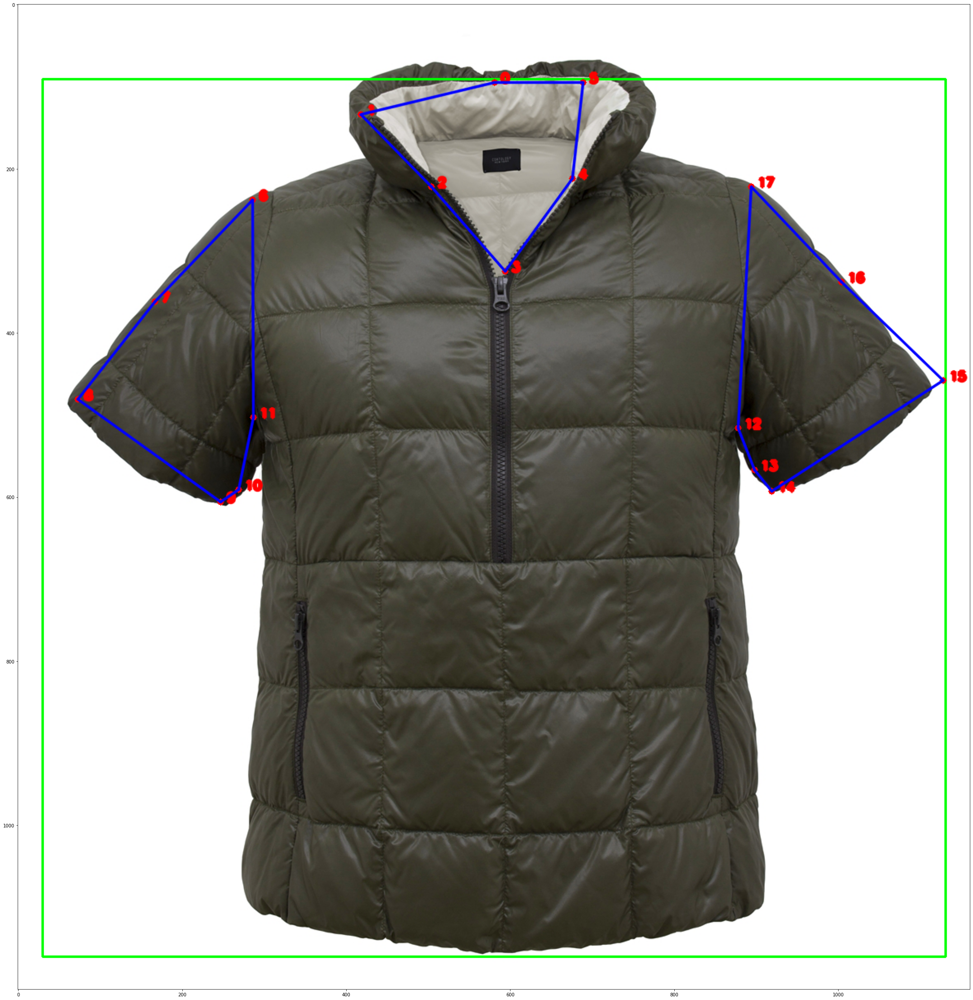

In [ ]:
img1 = Image.open("/content/images/34563-2.jpg")

tensor_img1 = transform(img1)

output1 = model([tensor_img1.to(device)])
image1 = (tensor_img1.permute(1,2,0).numpy() * 255).astype(np.uint8)
bboxes = [output1[0]['boxes'][0].detach().cpu().numpy().astype(np.int32).tolist()]

keypoints = []
for kps in output1[0]['keypoints'][0].detach().cpu().numpy().astype(np.int32).tolist():
    keypoints.append(kps[:-1])
keypoints = [keypoints]

visualize(image1, bboxes, keypoints)

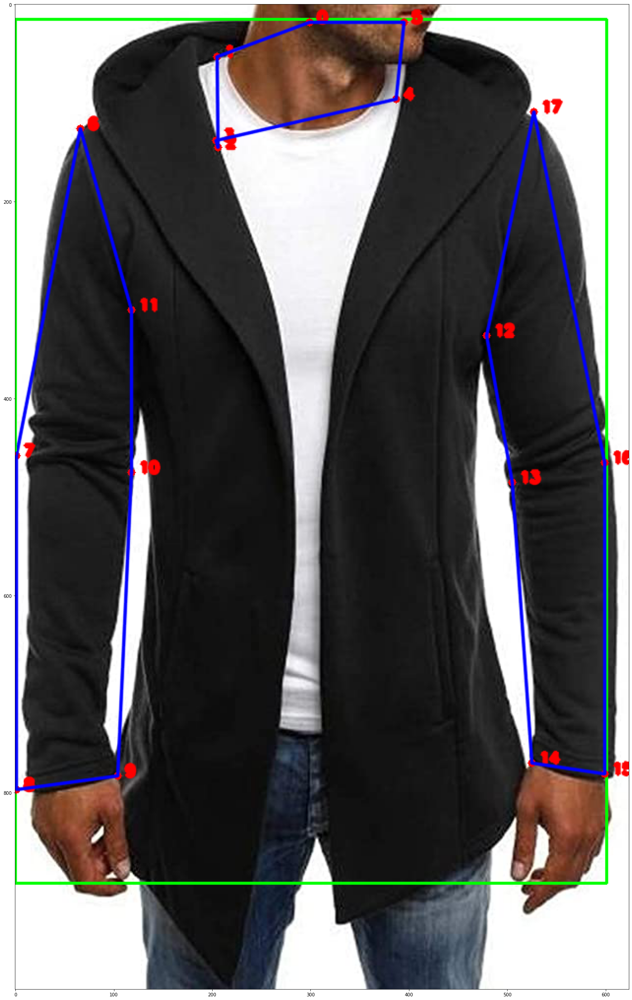

In [ ]:
img1 = Image.open("/content/images/519oYpnE3lL._AC_UY1000_.jpg")

tensor_img1 = transform(img1)

output1 = model([tensor_img1.to(device)])
image1 = (tensor_img1.permute(1,2,0).numpy() * 255).astype(np.uint8)
bboxes = [output1[0]['boxes'][0].detach().cpu().numpy().astype(np.int32).tolist()]

keypoints = []
for kps in output1[0]['keypoints'][0].detach().cpu().numpy().astype(np.int32).tolist():
    keypoints.append(kps[:-1])
keypoints = [keypoints]

visualize(image1, bboxes, keypoints)

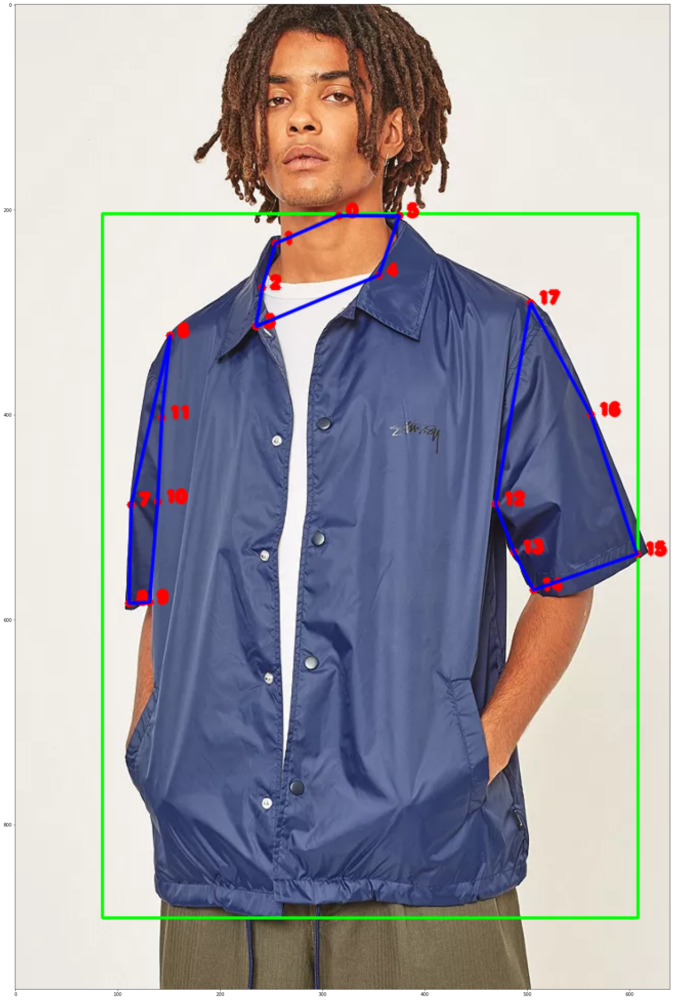

In [ ]:
img1 = Image.open("/content/images/5242427520300_041_b.webp")

tensor_img1 = transform(img1)

output1 = model([tensor_img1.to(device)])
image1 = (tensor_img1.permute(1,2,0).numpy() * 255).astype(np.uint8)
bboxes = [output1[0]['boxes'][0].detach().cpu().numpy().astype(np.int32).tolist()]

keypoints = []
for kps in output1[0]['keypoints'][0].detach().cpu().numpy().astype(np.int32).tolist():
    keypoints.append(kps[:-1])
keypoints = [keypoints]

visualize(image1, bboxes, keypoints)

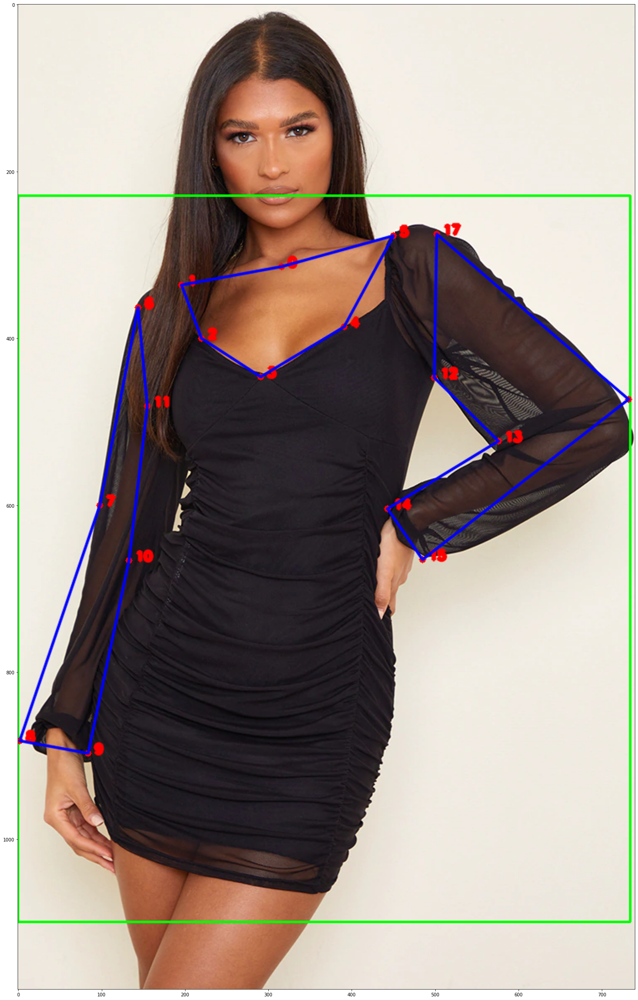

In [ ]:
img1 = Image.open("/content/images/79198ef6be7ec552021690c38bc5bc5d7cc18828_cmo8113_1.webp")

tensor_img1 = transform(img1)

output1 = model([tensor_img1.to(device)])
image1 = (tensor_img1.permute(1,2,0).numpy() * 255).astype(np.uint8)
bboxes = [output1[0]['boxes'][0].detach().cpu().numpy().astype(np.int32).tolist()]

keypoints = []
for kps in output1[0]['keypoints'][0].detach().cpu().numpy().astype(np.int32).tolist():
    keypoints.append(kps[:-1])
keypoints = [keypoints]

visualize(image1, bboxes, keypoints)

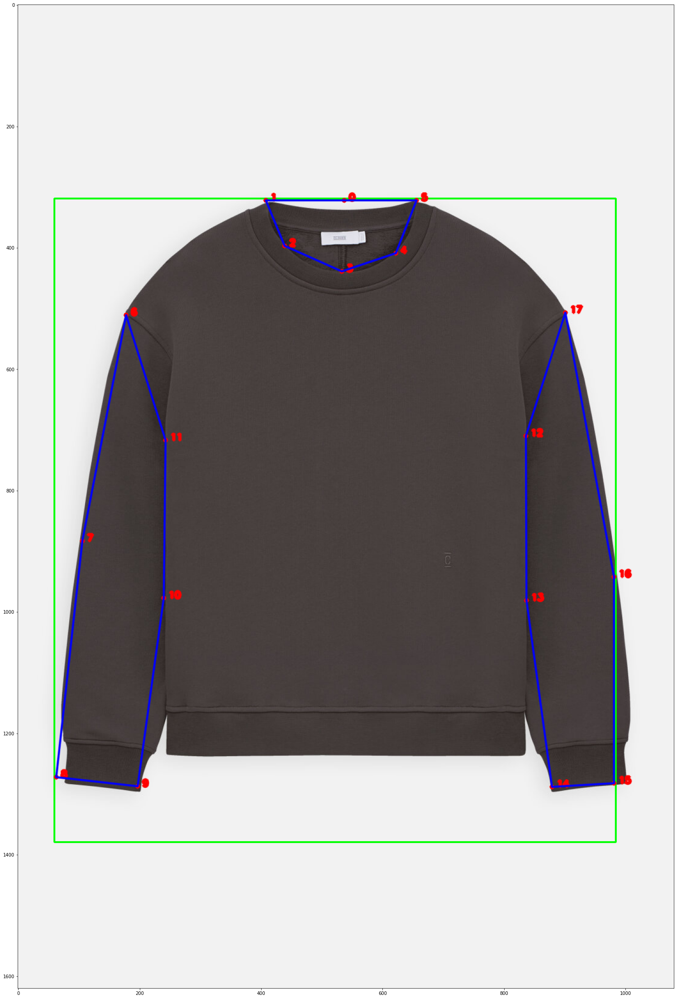

In [ ]:
img1 = Image.open("/content/images/C85229-47C-22-761.jpg")

tensor_img1 = transform(img1)

output1 = model([tensor_img1.to(device)])
image1 = (tensor_img1.permute(1,2,0).numpy() * 255).astype(np.uint8)
bboxes = [output1[0]['boxes'][0].detach().cpu().numpy().astype(np.int32).tolist()]

keypoints = []
for kps in output1[0]['keypoints'][0].detach().cpu().numpy().astype(np.int32).tolist():
    keypoints.append(kps[:-1])
keypoints = [keypoints]

visualize(image1, bboxes, keypoints)

# 2ème image

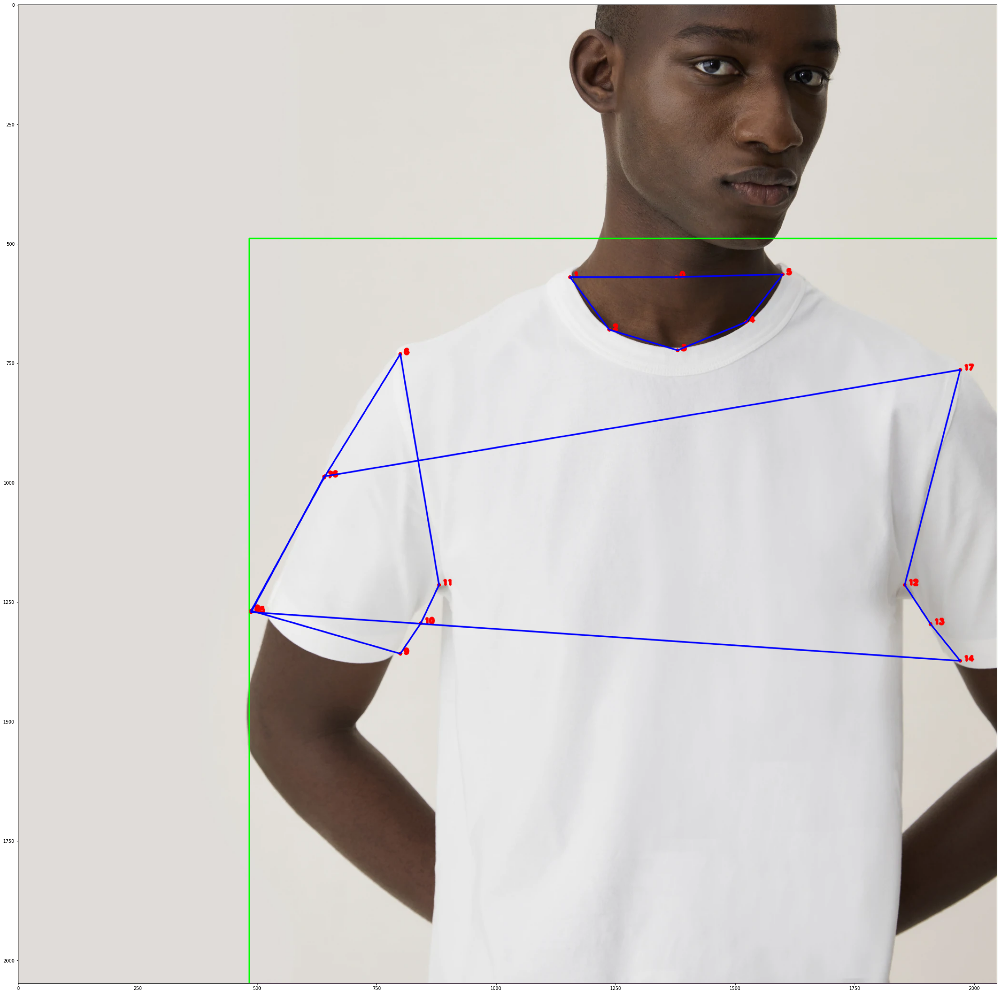

In [ ]:
img1 = Image.open("/content/images/t-shirtcotonbioblancloomface_2048x.webp")

tensor_img1 = transform(img1)

output1 = model([tensor_img1.to(device)])
image1 = (tensor_img1.permute(1,2,0).numpy() * 255).astype(np.uint8)
bboxes = [output1[0]['boxes'][0].detach().cpu().numpy().astype(np.int32).tolist()]

keypoints = []
for kps in output1[0]['keypoints'][0].detach().cpu().numpy().astype(np.int32).tolist():
    keypoints.append(kps[:-1])
keypoints = [keypoints]

visualize(image1, bboxes, keypoints)

In [ ]:
# image1 = (tensor_img1.permute(1,2,0).numpy() * 255).astype(np.uint8)
# bboxes = [output1[0]['boxes'][0].detach().cpu().numpy().astype(np.int32).tolist()]

# keypoints = []
# for kps in output1[0]['keypoints'][0].detach().cpu().numpy().astype(np.int32).tolist():
#     keypoints.append(kps[:-1])
# keypoints = [keypoints]

# visualize(image1, bboxes, keypoints)

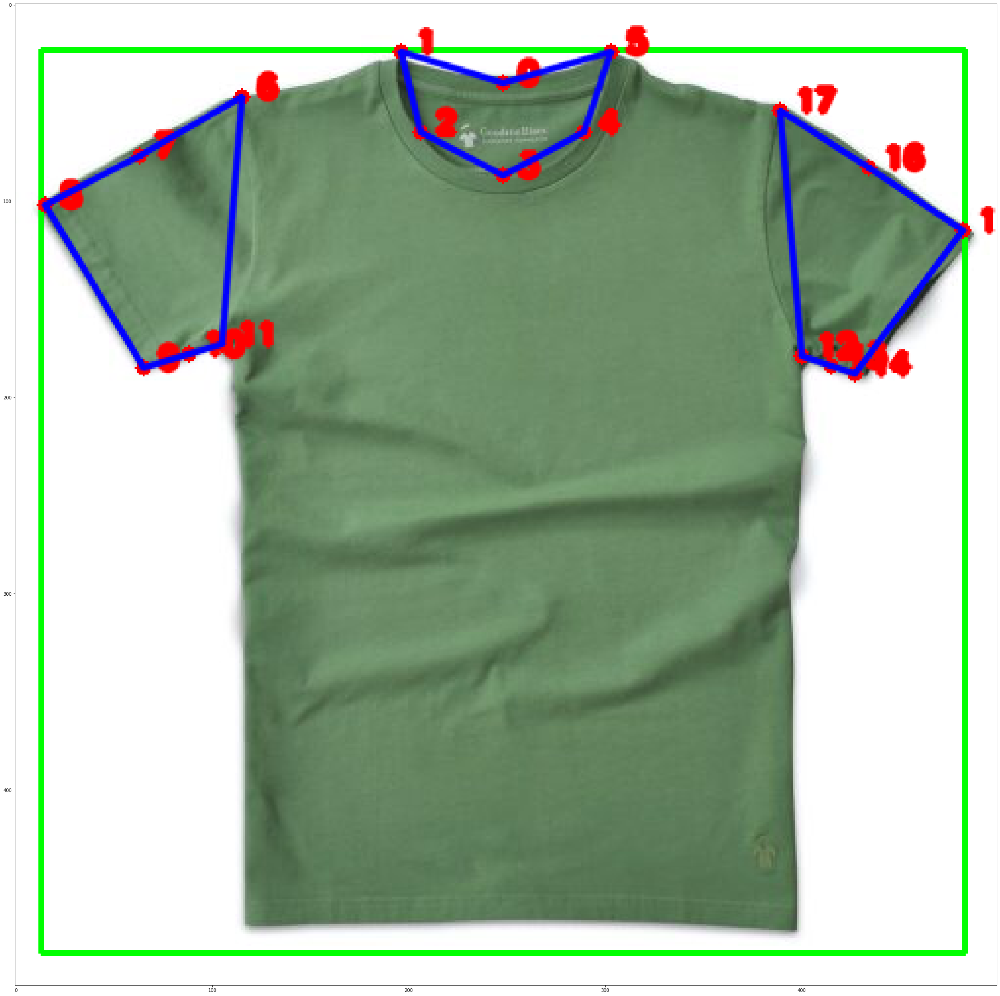

In [ ]:
img2 = Image.open("/content/images/t-shirt-vert-aventure-col-rond-pey407t1tfct0ne81ogobmigygi0tgib5h3zwzco7c.jpeg")

tensor_img2 = transform(img2)

output2 = model([tensor_img2.to(device)])
image2 = (tensor_img2.permute(1,2,0).numpy() * 255).astype(np.uint8)
bboxes = [output2[0]['boxes'][0].detach().cpu().numpy().astype(np.int32).tolist()]

keypoints = []
for kps in output2[0]['keypoints'][0].detach().cpu().numpy().astype(np.int32).tolist():
    keypoints.append(kps[:-1])
keypoints = [keypoints]

visualize(image2, bboxes, keypoints)

In [ ]:
# image2 = (tensor_img2.permute(1,2,0).numpy() * 255).astype(np.uint8)
# bboxes = [output2[0]['boxes'][0].detach().cpu().numpy().astype(np.int32).tolist()]

# keypoints = []
# for kps in output2[0]['keypoints'][0].detach().cpu().numpy().astype(np.int32).tolist():
#     keypoints.append(kps[:-1])
# keypoints = [keypoints]

# visualize(image2, bboxes, keypoints)

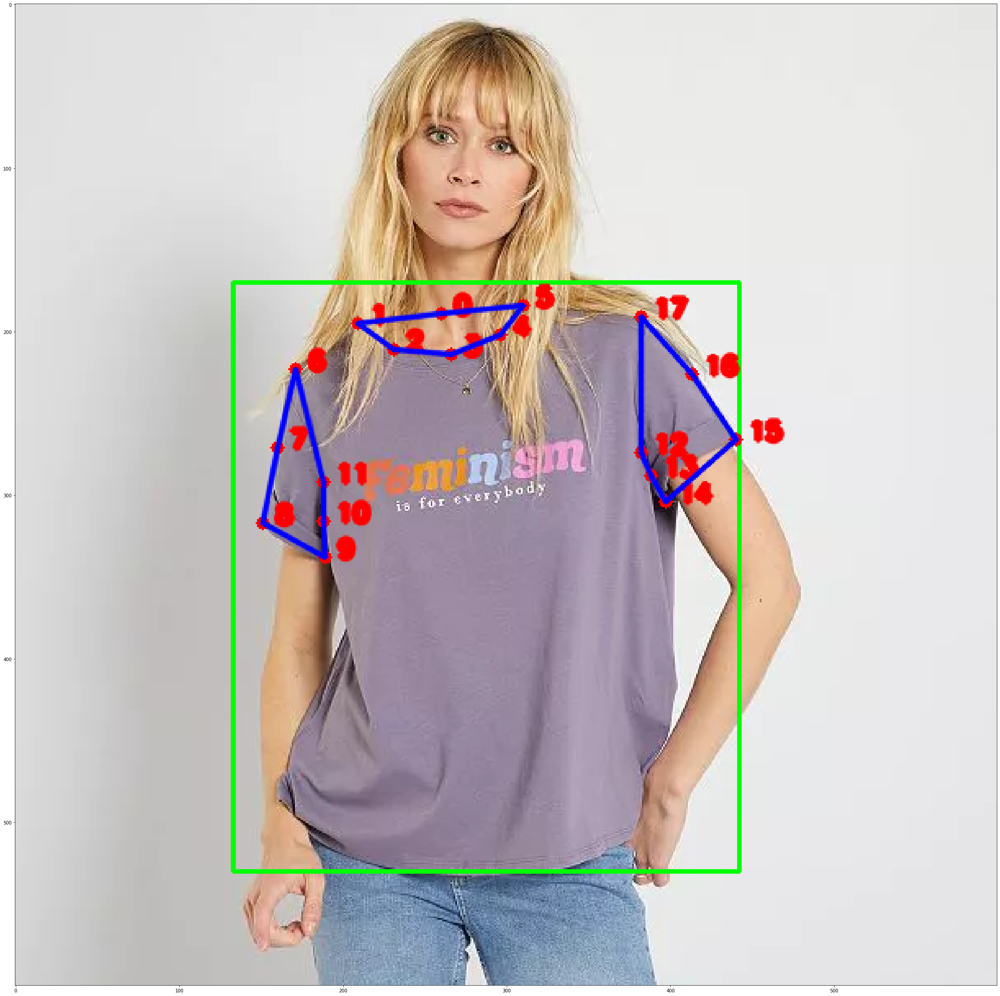

In [ ]:
img3 = Image.open("/content/images/t-shirt-imprime-journee-de-la-femme-violet-femme-du-34-au-48-yu573_1_fcf1.webp")

tensor_img3 = transform(img3)

output3 = model([tensor_img3.to(device)])
image3 = (tensor_img3.permute(1,2,0).numpy() * 255).astype(np.uint8)
bboxes = [output3[0]['boxes'][0].detach().cpu().numpy().astype(np.int32).tolist()]

keypoints = []
for kps in output3[0]['keypoints'][0].detach().cpu().numpy().astype(np.int32).tolist():
    keypoints.append(kps[:-1])
keypoints = [keypoints]

visualize(image3, bboxes, keypoints)

In [ ]:
# image3 = (tensor_img3.permute(1,2,0).numpy() * 255).astype(np.uint8)
# bboxes = [output3[0]['boxes'][0].detach().cpu().numpy().astype(np.int32).tolist()]

# keypoints = []
# for kps in output3[0]['keypoints'][0].detach().cpu().numpy().astype(np.int32).tolist():
#     keypoints.append(kps[:-1])
# keypoints = [keypoints]

# visualize(image3, bboxes, keypoints)

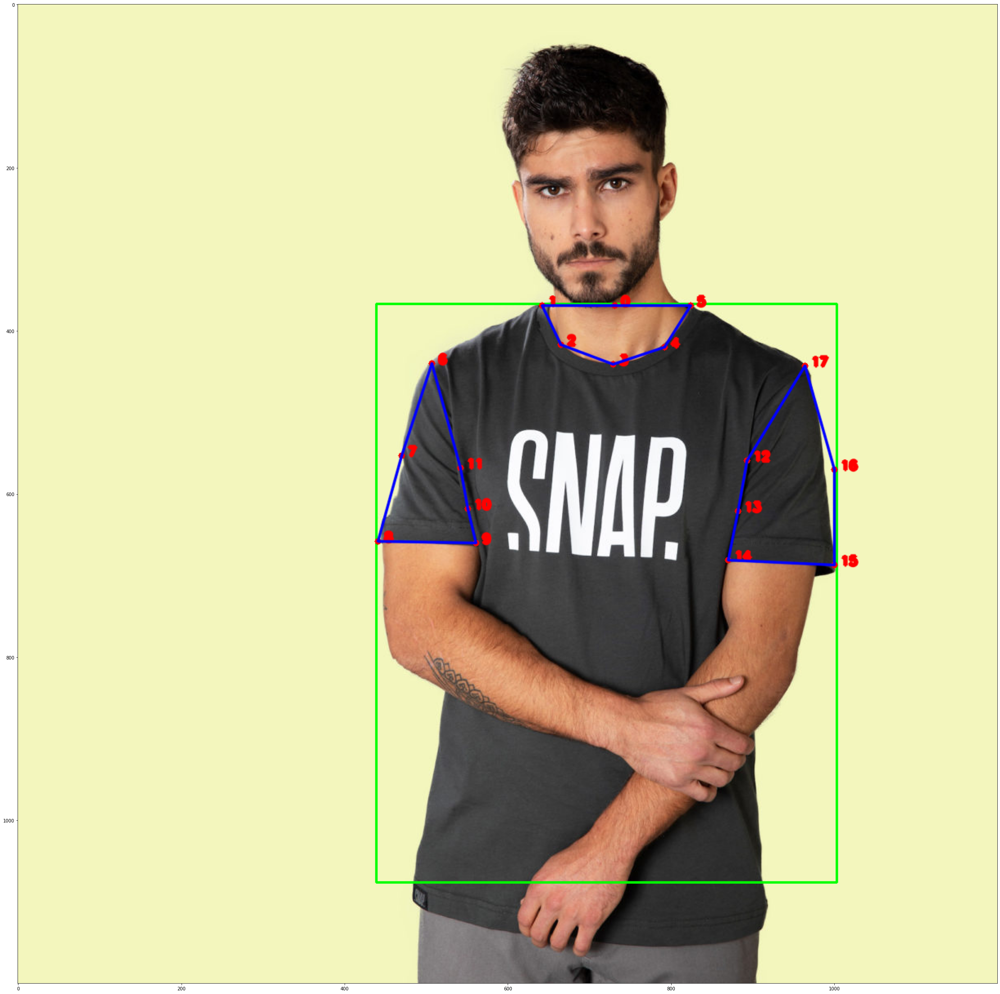

In [ ]:
img4 = Image.open("/content/images/snap_wear_man_logo-t-shirt_gris_face_détail-1200x1200.jpg")

tensor_img4 = transform(img4)

output4 = model([tensor_img4.to(device)])
image4 = (tensor_img4.permute(1,2,0).numpy() * 255).astype(np.uint8)
bboxes = [output4[0]['boxes'][0].detach().cpu().numpy().astype(np.int32).tolist()]

keypoints = []
for kps in output4[0]['keypoints'][0].detach().cpu().numpy().astype(np.int32).tolist():
    keypoints.append(kps[:-1])
keypoints = [keypoints]

visualize(image4, bboxes, keypoints)

In [ ]:
# image4 = (tensor_img4.permute(1,2,0).numpy() * 255).astype(np.uint8)
# bboxes = [output4[0]['boxes'][0].detach().cpu().numpy().astype(np.int32).tolist()]

# keypoints = []
# for kps in output4[0]['keypoints'][0].detach().cpu().numpy().astype(np.int32).tolist():
#     keypoints.append(kps[:-1])
# keypoints = [keypoints]

# visualize(image4, bboxes, keypoints)

In [ ]:
# img5 = Image.open("/content/images/img.webp")

# tensor_img5 = transform(img5)

# output5 = model([tensor_img5.to(device)])
# image5 = (tensor_img5.permute(1,2,0).numpy() * 255).astype(np.uint8)
# bboxes = [output5[0]['boxes'][0].detach().cpu().numpy().astype(np.int32).tolist()]

# keypoints = []
# for kps in output5[0]['keypoints'][0].detach().cpu().numpy().astype(np.int32).tolist():
#     keypoints.append(kps[:-1])
# keypoints = [keypoints]

# visualize(image5, bboxes, keypoints)

In [ ]:
# image5 = (tensor_img5.permute(1,2,0).numpy() * 255).astype(np.uint8)
# bboxes = [output5[0]['boxes'][0].detach().cpu().numpy().astype(np.int32).tolist()]

# keypoints = []
# for kps in output5[0]['keypoints'][0].detach().cpu().numpy().astype(np.int32).tolist():
#     keypoints.append(kps[:-1])
# keypoints = [keypoints]

# visualize(image5, bboxes, keypoints)

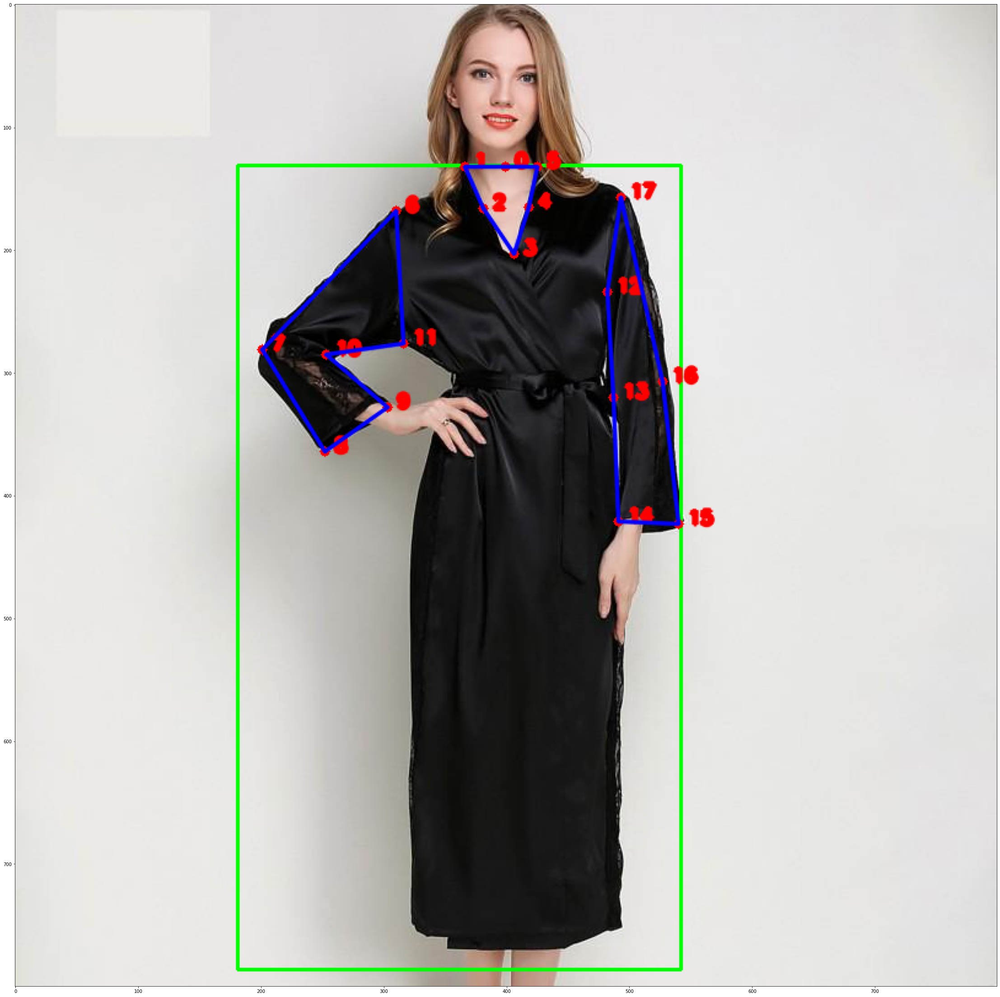

In [ ]:
img6 = Image.open("/content/images/dress1.jpg")

tensor_img6 = transform(img6)

output6 = model([tensor_img6.to(device)])
image6 = (tensor_img6.permute(1,2,0).numpy() * 255).astype(np.uint8)
bboxes = [output6[0]['boxes'][0].detach().cpu().numpy().astype(np.int32).tolist()]

keypoints = []
for kps in output6[0]['keypoints'][0].detach().cpu().numpy().astype(np.int32).tolist():
    keypoints.append(kps[:-1])
keypoints = [keypoints]

visualize(image6, bboxes, keypoints)

In [ ]:
# image6 = (tensor_img6.permute(1,2,0).numpy() * 255).astype(np.uint8)
# bboxes = [output6[0]['boxes'][0].detach().cpu().numpy().astype(np.int32).tolist()]

# keypoints = []
# for kps in output6[0]['keypoints'][0].detach().cpu().numpy().astype(np.int32).tolist():
#     keypoints.append(kps[:-1])
# keypoints = [keypoints]

# visualize(image6, bboxes, keypoints)

In [ ]:
# img7 = Image.open("/content/images/Long_Sleeve_Top_Flat_Lay_Back.jpg")

# tensor_img7 = transform(img7)

# output7 = model([tensor_img7.to(device)])
# image7 = (tensor_img7.permute(1,2,0).numpy() * 255).astype(np.uint8)
# bboxes = [output7[0]['boxes'][0].detach().cpu().numpy().astype(np.int32).tolist()]

# keypoints = []
# for kps in output7[0]['keypoints'][0].detach().cpu().numpy().astype(np.int32).tolist():
#     keypoints.append(kps[:-1])
# keypoints = [keypoints]

# visualize(image7, bboxes, keypoints)

In [ ]:
# image7 = (tensor_img7.permute(1,2,0).numpy() * 255).astype(np.uint8)
# bboxes = [output7[0]['boxes'][0].detach().cpu().numpy().astype(np.int32).tolist()]

# keypoints = []
# for kps in output7[0]['keypoints'][0].detach().cpu().numpy().astype(np.int32).tolist():
#     keypoints.append(kps[:-1])
# keypoints = [keypoints]

# visualize(image7, bboxes, keypoints)

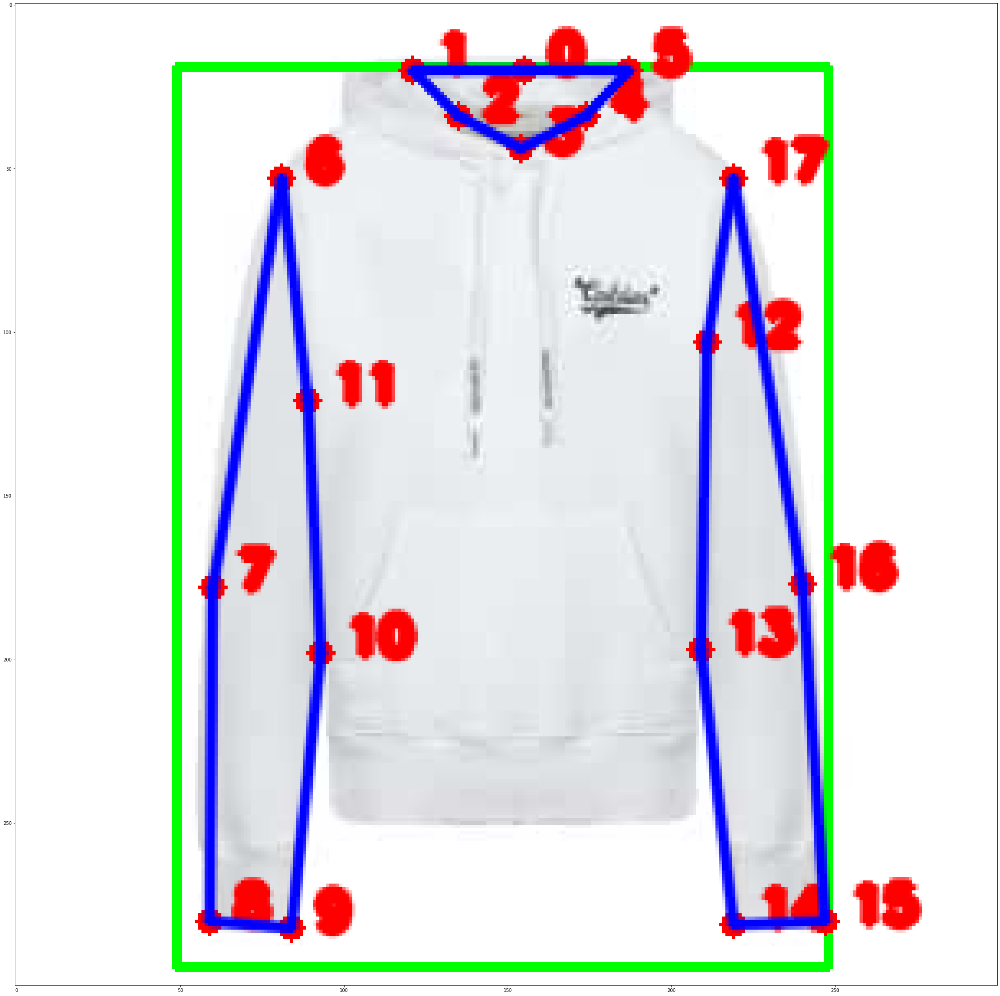

In [ ]:
img8 = Image.open("/content/images/golde37794-pck20211217-1.jpg")

tensor_img8 = transform(img8)

output8 = model([tensor_img8.to(device)])

image8 = (tensor_img8.permute(1,2,0).numpy() * 255).astype(np.uint8)
bboxes = [output8[0]['boxes'][0].detach().cpu().numpy().astype(np.int32).tolist()]

keypoints = []
for kps in output8[0]['keypoints'][0].detach().cpu().numpy().astype(np.int32).tolist():
    keypoints.append(kps[:-1])
keypoints = [keypoints]

visualize(image8, bboxes, keypoints)

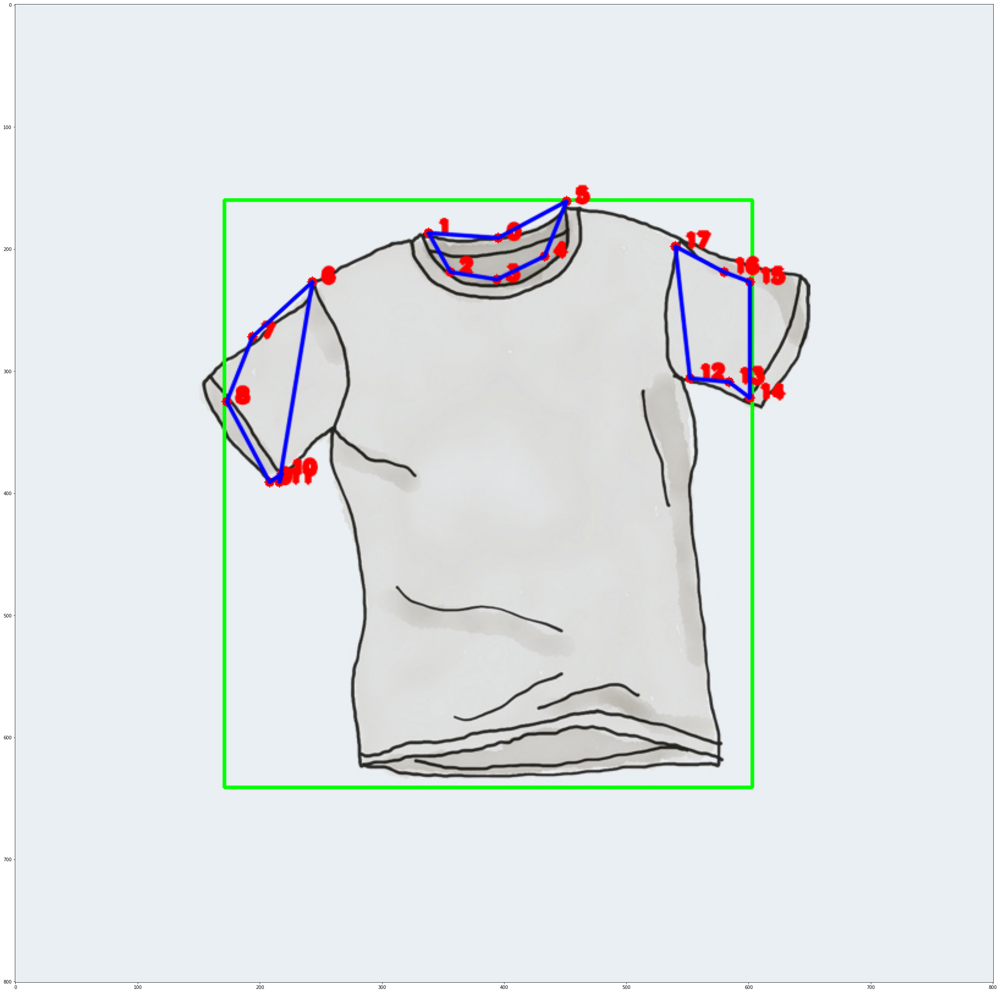

In [ ]:
img8 = Image.open("/content/images/tshirt-2.jpg")

tensor_img8 = transform(img8)

output8 = model([tensor_img8.to(device)])

image8 = (tensor_img8.permute(1,2,0).numpy() * 255).astype(np.uint8)
bboxes = [output8[0]['boxes'][0].detach().cpu().numpy().astype(np.int32).tolist()]

keypoints = []
for kps in output8[0]['keypoints'][0].detach().cpu().numpy().astype(np.int32).tolist():
    keypoints.append(kps[:-1])
keypoints = [keypoints]

visualize(image8, bboxes, keypoints)

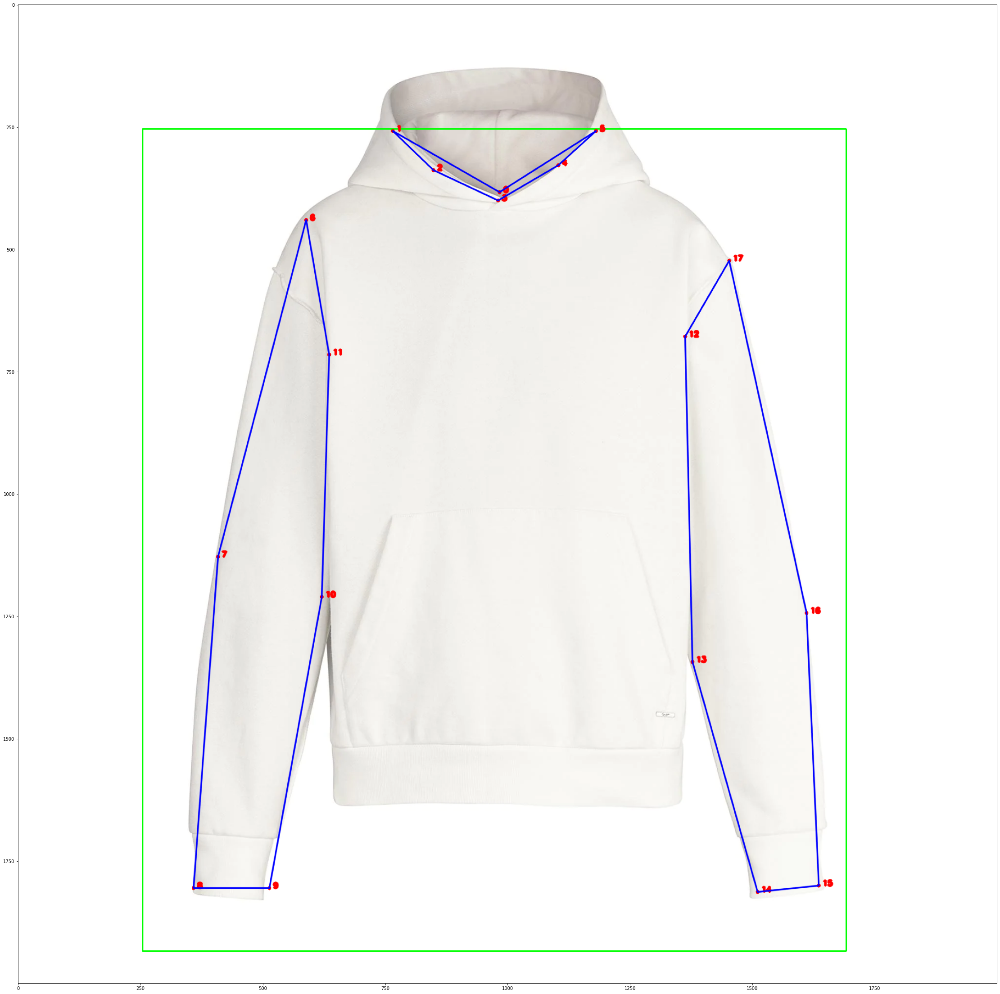

In [ ]:
img2 = Image.open("/content/images/louis-vuitton-sweatshirt-à-capuche-prêt-à-porter--HIY48WNPH002_PM2_Front view.webp")

tensor_img2 = transform(img2)

output2 = model([tensor_img2.to(device)])
image2 = (tensor_img2.permute(1,2,0).numpy() * 255).astype(np.uint8)
bboxes = [output2[0]['boxes'][0].detach().cpu().numpy().astype(np.int32).tolist()]

keypoints = []
for kps in output2[0]['keypoints'][0].detach().cpu().numpy().astype(np.int32).tolist():
    keypoints.append(kps[:-1])
keypoints = [keypoints]

visualize(image2, bboxes, keypoints)

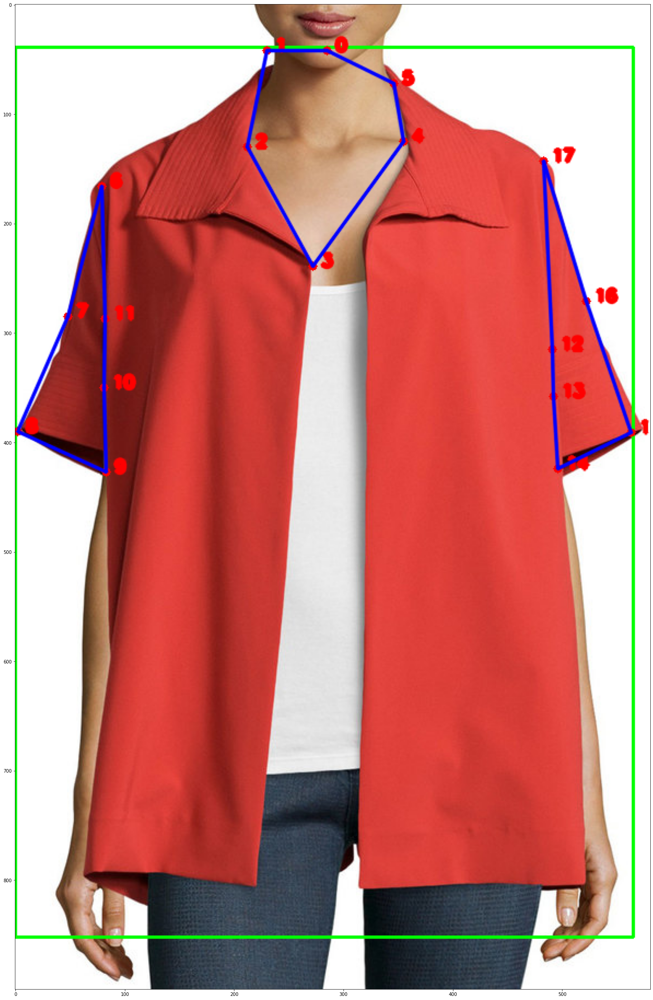

In [ ]:
img3 = Image.open("/content/images/bistretch-short-sleeve-jacket-tomato-red-original-283464.jpg")

tensor_img3 = transform(img3)

output3 = model([tensor_img3.to(device)])
image3 = (tensor_img3.permute(1,2,0).numpy() * 255).astype(np.uint8)
bboxes = [output3[0]['boxes'][0].detach().cpu().numpy().astype(np.int32).tolist()]

keypoints = []
for kps in output3[0]['keypoints'][0].detach().cpu().numpy().astype(np.int32).tolist():
    keypoints.append(kps[:-1])
keypoints = [keypoints]

visualize(image3, bboxes, keypoints)

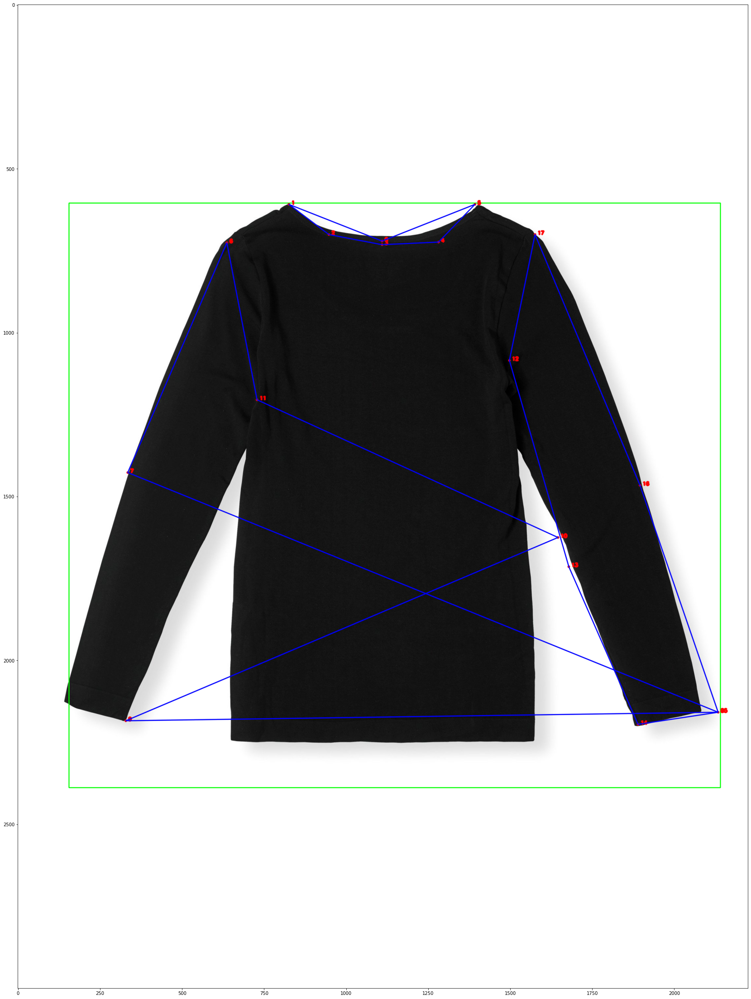

In [ ]:
img4 = Image.open("/content/images/Long_Sleeve_Top_Flat_Lay_Back.jpg")

tensor_img4 = transform(img4)

output4 = model([tensor_img4.to(device)])
image4 = (tensor_img4.permute(1,2,0).numpy() * 255).astype(np.uint8)
bboxes = [output4[0]['boxes'][0].detach().cpu().numpy().astype(np.int32).tolist()]

keypoints = []
for kps in output4[0]['keypoints'][0].detach().cpu().numpy().astype(np.int32).tolist():
    keypoints.append(kps[:-1])
keypoints = [keypoints]

visualize(image4, bboxes, keypoints)

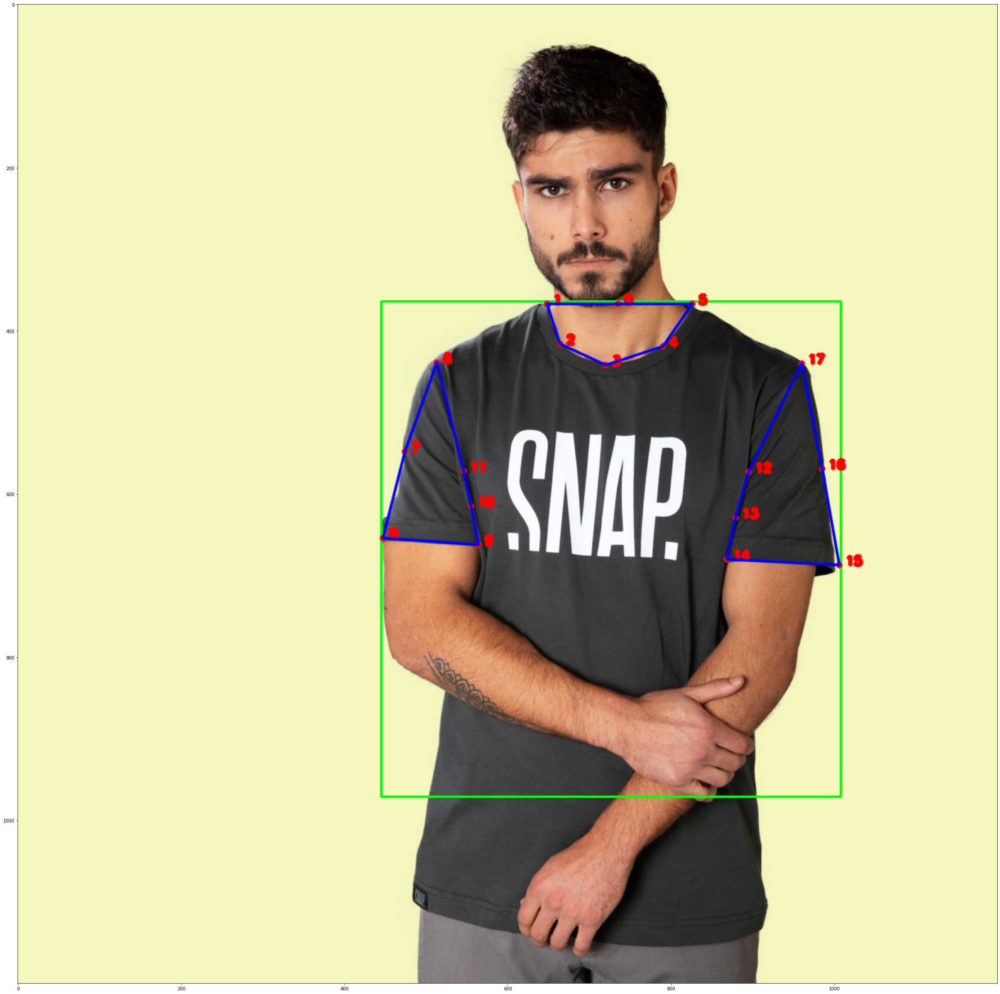

In [ ]:
# img5 = Image.open("/content/images/img.webp")

# tensor_img5 = transform(img5)

# output5 = model([tensor_img5.to(device)])

FileNotFoundError: ignored

In [ ]:
# image5 = (tensor_img5.permute(1,2,0).numpy() * 255).astype(np.uint8)
# bboxes = [output5[0]['boxes'][0].detach().cpu().numpy().astype(np.int32).tolist()]

# keypoints = []
# for kps in output5[0]['keypoints'][0].detach().cpu().numpy().astype(np.int32).tolist():
#     keypoints.append(kps[:-1])
# keypoints = [keypoints]

# visualize(image5, bboxes, keypoints)

In [ ]:
# img6 = Image.open("/content/images/dress1.jpg")

# tensor_img6 = transform(img6)

# output6 = model([tensor_img6.to(device)])

In [ ]:
# image6 = (tensor_img6.permute(1,2,0).numpy() * 255).astype(np.uint8)
# bboxes = [output6[0]['boxes'][0].detach().cpu().numpy().astype(np.int32).tolist()]

# keypoints = []
# for kps in output6[0]['keypoints'][0].detach().cpu().numpy().astype(np.int32).tolist():
#     keypoints.append(kps[:-1])
# keypoints = [keypoints]

# visualize(image6, bboxes, keypoints)

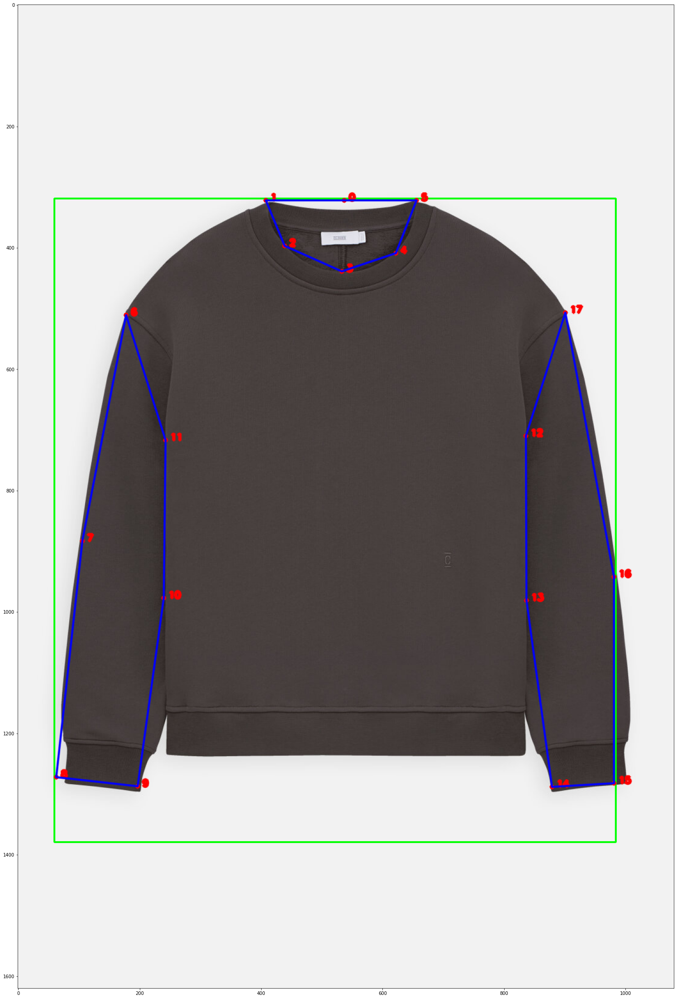

In [ ]:
img7 = Image.open("/content/images/C85229-47C-22-761.jpg")

tensor_img7 = transform(img7)

output7 = model([tensor_img7.to(device)])
image7 = (tensor_img7.permute(1,2,0).numpy() * 255).astype(np.uint8)
bboxes = [output7[0]['boxes'][0].detach().cpu().numpy().astype(np.int32).tolist()]

keypoints = []
for kps in output7[0]['keypoints'][0].detach().cpu().numpy().astype(np.int32).tolist():
    keypoints.append(kps[:-1])
keypoints = [keypoints]

visualize(image7, bboxes, keypoints)

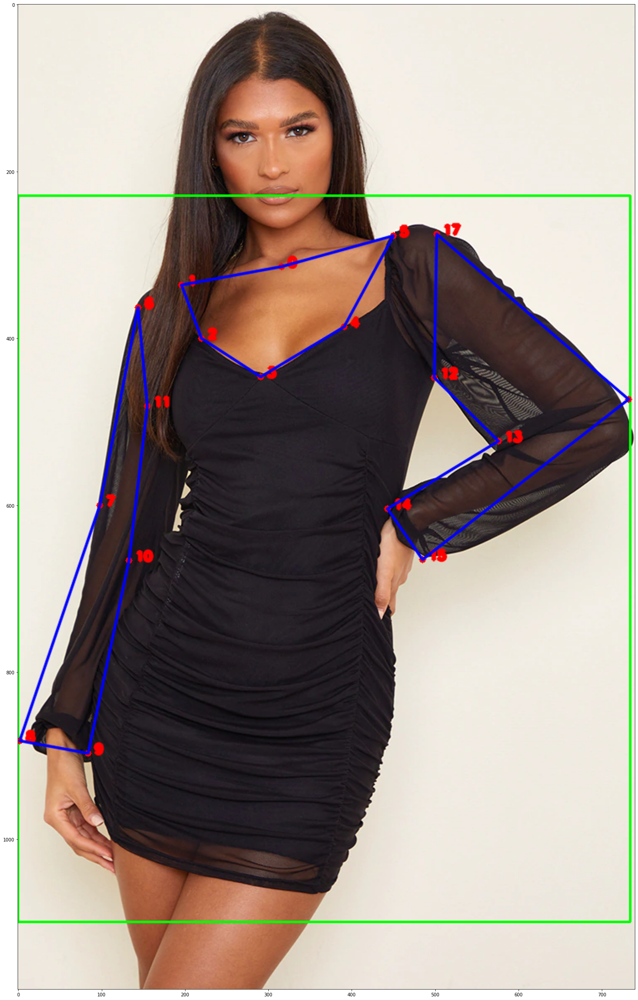

In [ ]:
img8 = Image.open("/content/images/79198ef6be7ec552021690c38bc5bc5d7cc18828_cmo8113_1.webp")

tensor_img8 = transform(img8)

output8 = model([tensor_img8.to(device)])

image8 = (tensor_img8.permute(1,2,0).numpy() * 255).astype(np.uint8)
bboxes = [output8[0]['boxes'][0].detach().cpu().numpy().astype(np.int32).tolist()]

keypoints = []
for kps in output8[0]['keypoints'][0].detach().cpu().numpy().astype(np.int32).tolist():
    keypoints.append(kps[:-1])
keypoints = [keypoints]

visualize(image8, bboxes, keypoints)

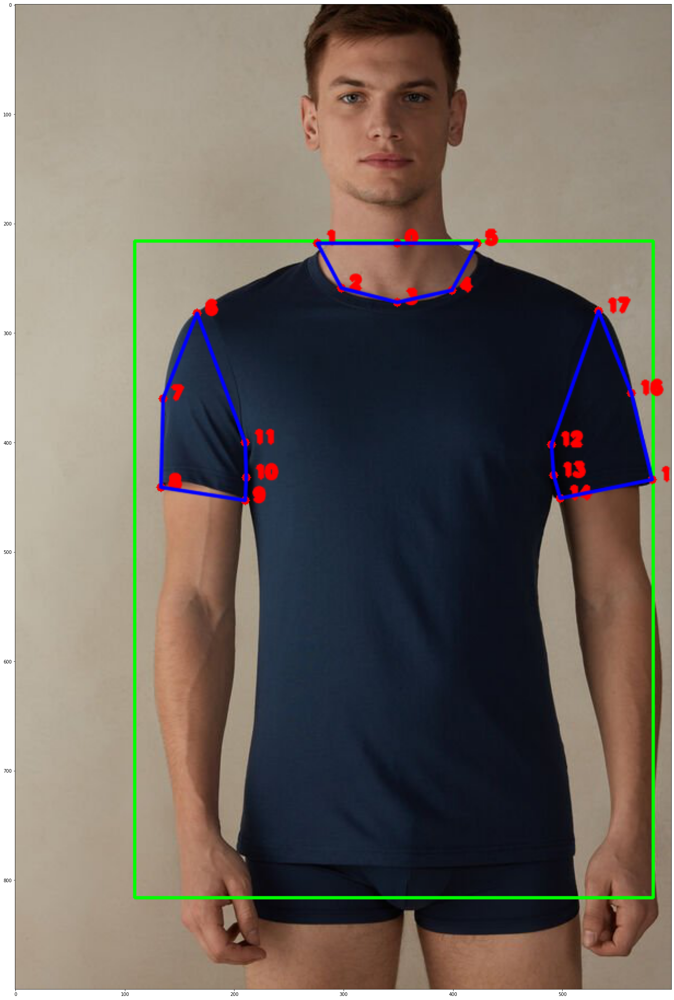

In [ ]:
img8 = Image.open("/content/images/CMU12G860I-FI.jpg")

tensor_img8 = transform(img8)

output8 = model([tensor_img8.to(device)])

image8 = (tensor_img8.permute(1,2,0).numpy() * 255).astype(np.uint8)
bboxes = [output8[0]['boxes'][0].detach().cpu().numpy().astype(np.int32).tolist()]

keypoints = []
for kps in output8[0]['keypoints'][0].detach().cpu().numpy().astype(np.int32).tolist():
    keypoints.append(kps[:-1])
keypoints = [keypoints]

visualize(image8, bboxes, keypoints)